## Calibrating Camera

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob 
% matplotlib inline


In [2]:

images = glob.glob('camera_cal/calibration*.jpg')
nx = 9
ny = 6
objpoints = []
imgpoints = []
objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

for fname in images:
    
    img = mpimg.imread(fname)

    # Convert to grayscale
    undist = np.copy(img)  # Delete this line
    gray = cv2.cvtColor(undist,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # If found, draw corners
   
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        # Draw and display the corners

        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)

Text(0.5,1,'Undistorted Images')

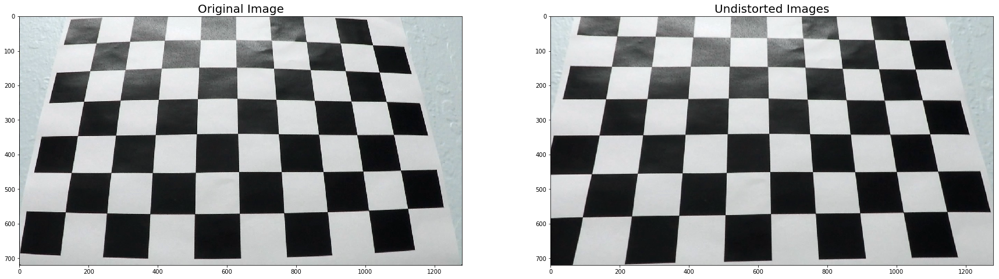

In [3]:
img = cv2.imread('camera_cal/calibration3.jpg')
img_size = (img.shape[1], img.shape[0])


ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

dst = cv2.undistort(img, mtx, dist, None, mtx)

f, axes= plt.subplots(1,2,figsize=(30,30))


axes[0].imshow(img)
axes[0].set_title("Original Image", fontsize=20)
axes[1].imshow(dst)
axes[1].set_title("Undistorted Images", fontsize=20)

### Undistort main image


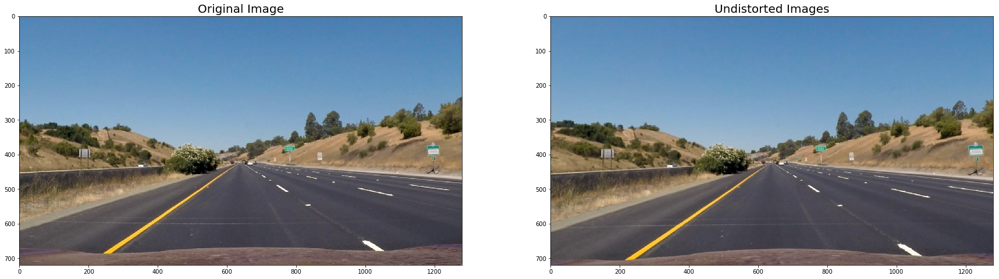

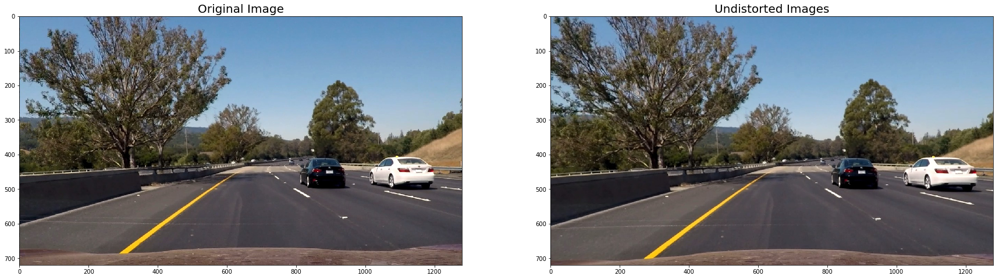

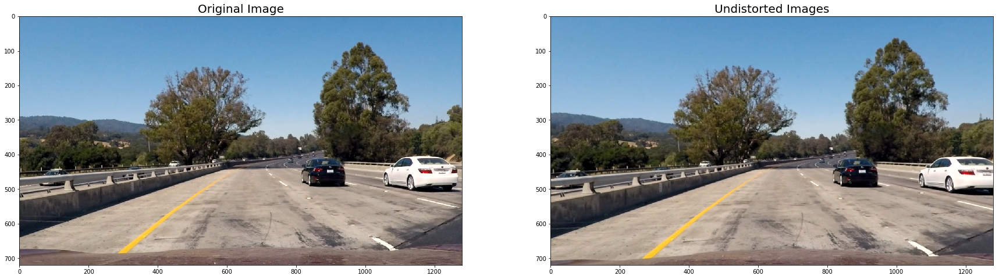

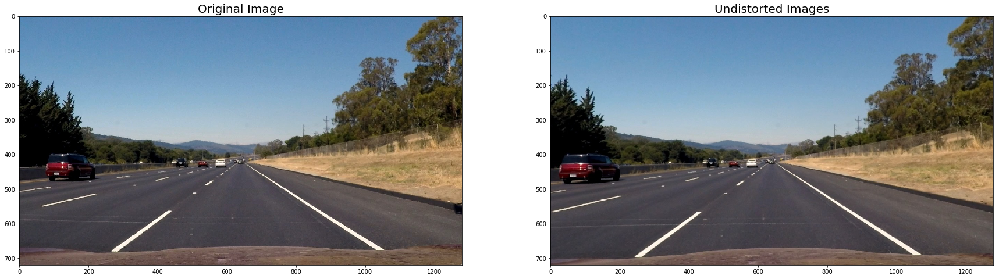

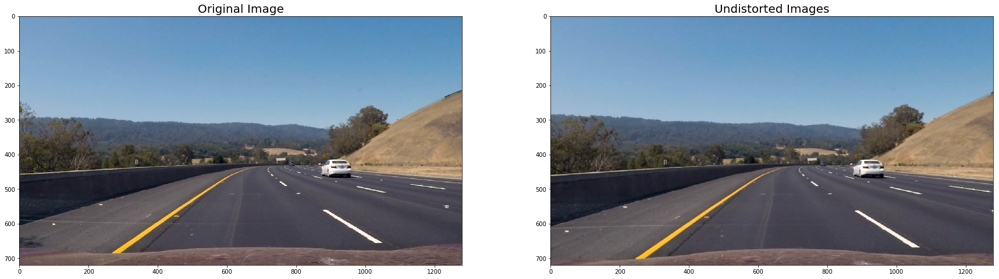

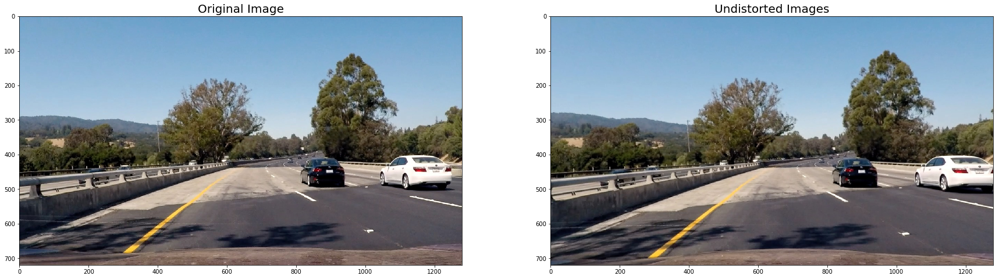

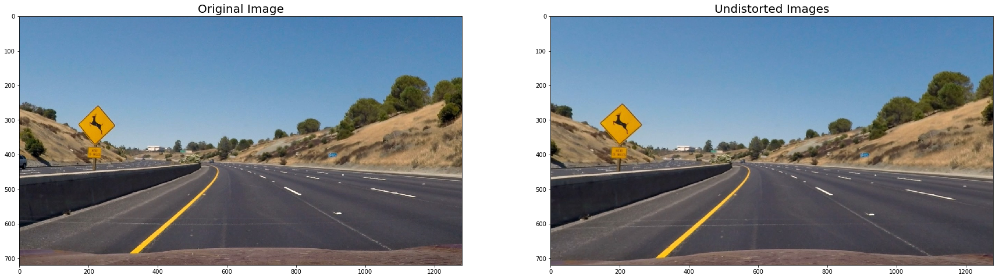

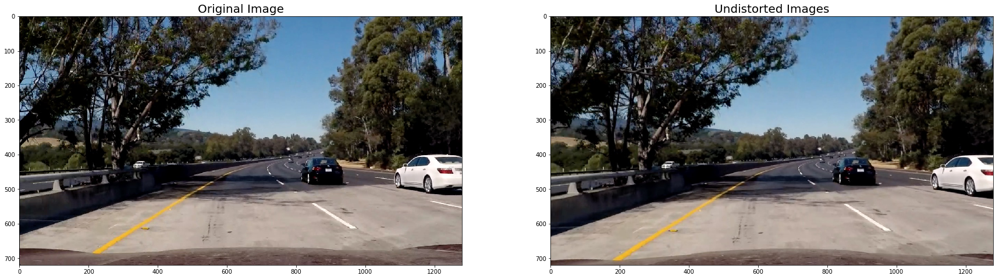

In [4]:
def undistort_image(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

for fname in glob.glob('test_images/*'):
    
    img = mpimg.imread(fname)
    undist_img = undistort_image(img, mtx, dist)
    f, axes= plt.subplots(1,2,figsize=(30,30))


    axes[0].imshow(img)
    axes[0].set_title("Original Image", fontsize=20)
    axes[1].imshow(undist_img)
    axes[1].set_title("Undistorted Images", fontsize=20)

## Color Spaces and Gradient Thresholding

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
33314.714795368505 822.0705961373075 Vehicle is -0.10m left



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
2545.2825408942726 2851.6488503668725 Vehicle is 0.50m right



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
1211.168619477214 1226.584883047708 Vehicle is 0.21m right



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
5077.336817008633 92672.7368211225 Vehicle is -0.10m left



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
2151.7584152579957 2231.329944167924 Vehicle is 0.36m right



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
7656.268818171003 462.8581585211903 Vehicle is 0.48m right



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
1920.5001043889122 3203.6760099635644 Vehicle is 0.06m right



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


IM here
1061.3658715620222 1404.6269086664017 Vehicle is 0.09m right



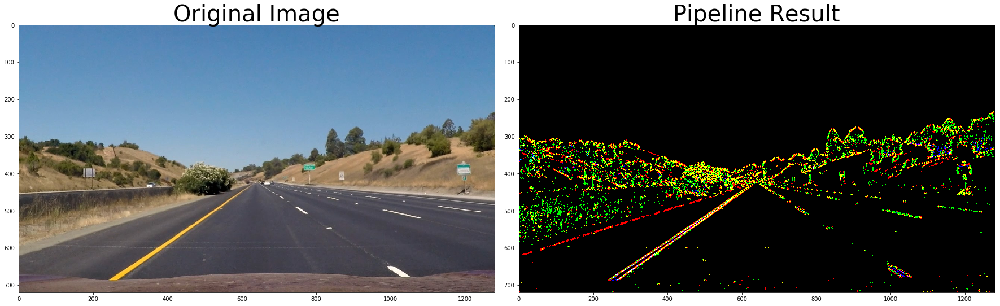

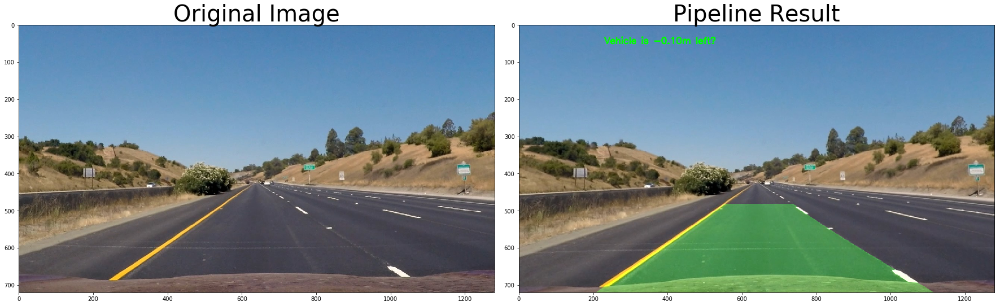

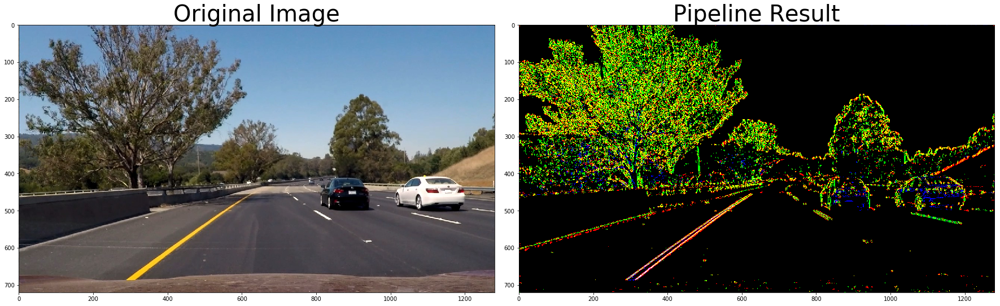

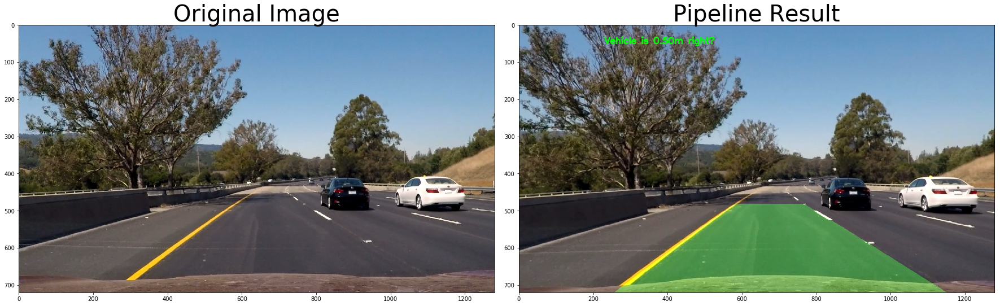

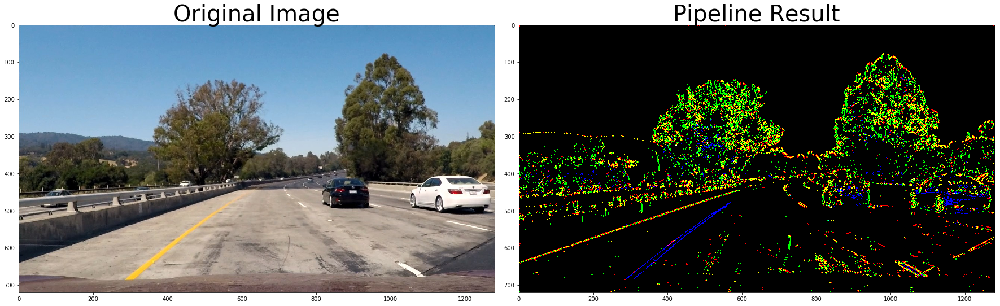

...

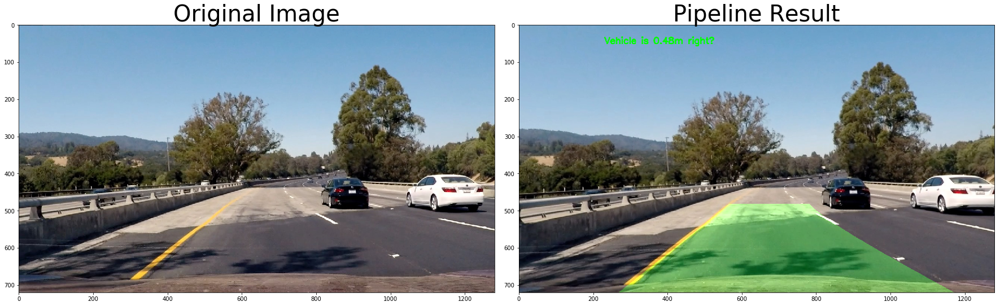

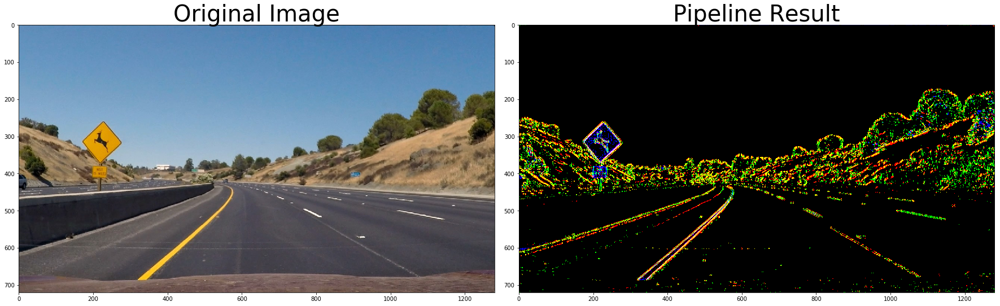

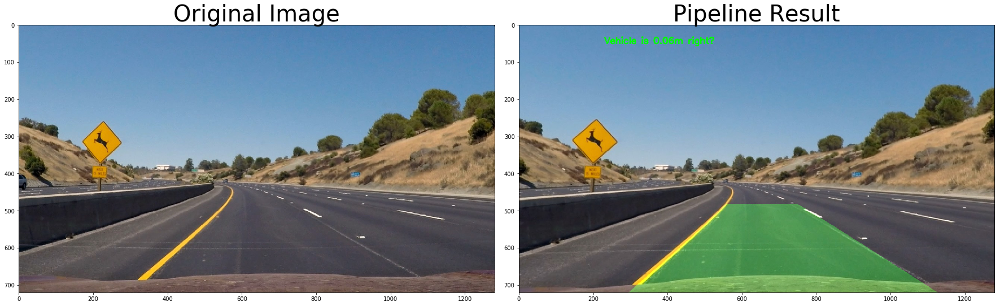

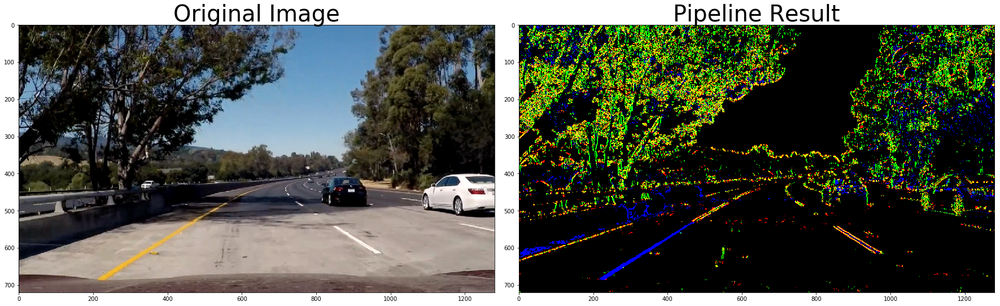

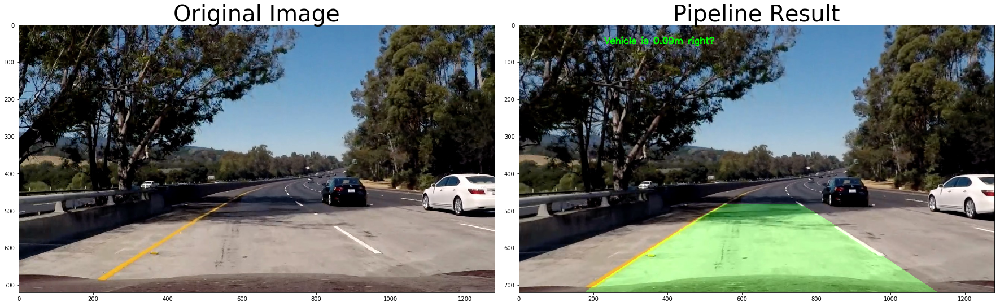

In [7]:
# Gradient and color spaces thresholding
for fname in glob.glob('test_images/*'):

    img = mpimg.imread(fname)
    undist_img = undistort_image(img, mtx, dist)
    image = np.copy(img)

    # Define a function that applies Sobel x or y, 
    # then takes an absolute value and applies a threshold.
    # Note: calling your function with orient='x', thresh_min=5, thresh_max=100
    # should produce output like the example image shown above this quiz.
    def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):  
        # Apply the following steps to img
        # 1) Convert to grayscale

        # 2) Take the derivative in x or y given orient = 'x' or 'y

        # 3) Take the absolute value of the derivative or gradient
        # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
        # 5) Create a mask of 1's where the scaled gradient magnitude 
                # is > thresh_min and < thresh_max
        # 6) Return this mask as your binary_output image
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Apply x or y gradient with the OpenCV Sobel() function
        # and take the absolute value
        if orient == 'x':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
        if orient == 'y':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
        # Rescale back to 8 bit integer
        scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
        # Create a copy and apply the threshold
        binary_output = np.zeros_like(scaled_sobel)
        # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
        binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

        # Return the result
        return binary_output

    def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):

        # Apply the following steps to img
        # 1) Convert to grayscale
        # 2) Take the gradient in x and y separately
        # 3) Calculate the magnitude 
        # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
        # 5) Create a binary mask where mag thresholds are met
        # 6) Return this mask as your binary_output image
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Take both Sobel x and y gradients
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        # Calculate the gradient magnitude
        gradmag = np.sqrt(sobelx**2 + sobely**2)
        # Rescale to 8 bit
        scale_factor = np.max(gradmag)/255 
        gradmag = (gradmag/scale_factor).astype(np.uint8) 
        # Create a binary image of ones where threshold is met, zeros otherwise
        binary_output = np.zeros_like(gradmag)
        binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

        return binary_output

    def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):

        # Apply the following steps to img
        # 1) Convert to grayscale
        # 2) Take the gradient in x and y separately
        # 3) Take the absolute value of the x and y gradients
        # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
        # 5) Create a binary mask where direction thresholds are met
        # 6) Return this mask as your binary_output image
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Calculate the x and y gradients
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        # Take the absolute value of the gradient direction, 
        # apply a threshold, and create a binary image result
        absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
        binary_output =  np.zeros_like(absgraddir)
        binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

        return binary_output

    # Edit this function to create your own pipeline.
    def hls_threshold(img, s_thresh=(170, 245), sx_thresh=(20, 100)):
        img = np.copy(img)
        # Convert to HLS color space and separate the V channel
        hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        l_channel = hls[:,:,1]
        s_channel = hls[:,:,2]
        # Sobel x
        sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
        abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
        scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

        # Threshold x gradient
        sxbinary = np.zeros_like(scaled_sobel)
        sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1

        # Threshold color channel
        s_binary = np.zeros_like(s_channel)
        s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
        # Stack each channel

        return sxbinary, s_binary



        # Choose a Sobel kernel size
    ksize = 3 # Choose a larger odd number to smooth gradient measurements

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    sxbinary,s_binary = hls_threshold(image)


    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

    ##B&W binary
    final_combined_binary = np.zeros_like(dir_binary)
    final_combined_binary[(combined == 1) | (sxbinary == 1) | (s_binary == 1)] = 1

    ##color binary
    color_binary = np.dstack((combined, sxbinary, s_binary)) * 255
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255

    # Plot the result(commented for now/)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(color_binary)
    ax2.set_title('Pipeline Result', fontsize=40)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    # Create binary thresholded images to isolate lane line pixels


    



    #### Perspective transform

    def transform_image(img): 


        # Grab the image shape
        img_size = (img.shape[1], img.shape[0])

        leftupperpoint  = [570,470]
        rightupperpoint = [720,470]
        leftlowerpoint  = [260,680]
        rightlowerpoint = [1045,680]
        src = np.float32([leftupperpoint, leftlowerpoint, rightupperpoint, rightlowerpoint])
        dst = np.float32([[200,0], [200,680], [1000,0], [1000,680]])
        # Given src and dst points, calculate the perspective transform matrix
        src = np.float32([[490, 482],[810, 482],
                      [1250, 720],[40, 720]])
        dst = np.float32([[0, 0], [1280, 0], 
                     [1250, 720],[40, 720]])
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)

        return warped, M

    warped,M = transform_image(final_combined_binary)
    # Plot the result(commented for now)
    #f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    #f.tight_layout()

    #ax1.imshow(image)
    #ax1.set_title('Original Image', fontsize=40)

    #ax2.imshow(warped)
    #ax2.set_title('Pipeline Result', fontsize=40)
    #plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



    #####lane pixels

    def find_lane_pixels(warped):
        # Take a histogram of the bottom half of the image
        histogram = np.sum(warped[warped.shape[0]//2:,:], axis=0)
        # Create an output image to draw on and visualize the result
        out1_img = np.dstack((warped, warped, warped))
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # HYPERPARAMETERS
        # Choose the number of sliding windows
        nwindows = 9
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50

        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(warped.shape[0]//nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated later for each window in nwindows
        leftx_current = leftx_base
        rightx_current = rightx_base

        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = warped.shape[0] - (window+1)*window_height
            win_y_high = warped.shape[0] - window*window_height
            ### TO-DO: Find the four below boundaries of the window ###
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin

            # Draw the windows on the visualization image
          # Draw the windows on the visualization image
            cv2.rectangle(out1_img,(win_xleft_low,win_y_low),
            (win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out1_img,(win_xright_low,win_y_low),
            (win_xright_high,win_y_high),(0,255,0), 2) 
            #plt.imshow(out1_img)

            ### TO-DO: Identify the nonzero pixels in x and y within the window ###
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]


            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)


            ### TO-DO: If you found > minpix pixels, recenter next window ###
            ### (`right` or `leftx_current`) on their mean position ###
            if len(good_left_inds) > minpix:
                    leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                    rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            left_lane_inds = np.concatenate(left_lane_inds)
            right_lane_inds = np.concatenate(right_lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            pass


        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]



        return leftx, lefty, rightx, righty, out1_img

    def fit_polynomial(warped):
    # Find our lane pixels first
        leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped)

        ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)

        # Generate x and y values for plotting
        ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
        try:
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        except TypeError:
            # Avoids an error if `left` and `right_fit` are still none or incorrect
            print('The function failed to fit a line!')
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty

        ## Visualization ##
        # Colors in the left and right lane regions
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]



        print('IM here')
        # Plot the result
        #f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        #f.tight_layout()

        #ax1.imshow(image)
        #ax1.set_title('Original Image', fontsize=40)

        #ax2.imshow(out_img)
            # Plots the left and right polynomials on the lane lines
        #ax2.plot(left_fitx, ploty, color='yellow')
        #ax2.plot(right_fitx, ploty, color='yellow')
        #ax2.set_title('Pipeline Result', fontsize=40)
        #plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

        return out_img,left_fit,right_fit


    out_img,left_fit,right_fit = fit_polynomial(warped)
    
    ##### curvature
    
    
    def radius_curvature(warped, left_fit, right_fit):

        ploty = np.linspace(0,warped.shape[0]-1,warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension
        y_eval = np.max(ploty)

        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)

        # Calculate the new radii of curvature
        left_curvature =  ((1 + (2*left_fit_cr[0] *y_eval*ym_per_pix + left_fit_cr[1])**2) **1.5) / np.absolute(2*left_fit_cr[0])
        right_curvature = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

        # Calculate vehicle center
        #left_lane and right lane bottom in pixels
        left_lane_bottom = (left_fit[0]*y_eval)**2 + left_fit[0]*y_eval + left_fit[2]
        right_lane_bottom = (right_fit[0]*y_eval)**2 + right_fit[0]*y_eval + right_fit[2]

        # Lane center as mid of left and right lane bottom                        
        lane_center = (left_lane_bottom + right_lane_bottom)/2.
        center_image = 640
        center = (lane_center - center_image)*xm_per_pix #Convert to meters
        position = "left" if center < 0 else "right"
        center = "Vehicle is {:.2f}m {}\n".format(center, position)

        # Now our radius of curvature is in meters
        return left_curvature, right_curvature, center,ploty,left_fitx,right_fitx
    
    left_curvature, right_curvature, center,ploty,left_fitx,right_fitx=radius_curvature(warped, left_fit, right_fit)
  
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    leftupperpoint  = [570,470]
    rightupperpoint = [720,470]
    leftlowerpoint  = [260,680]
    rightlowerpoint = [1045,680]
    src = np.float32([leftupperpoint, leftlowerpoint, rightupperpoint, rightlowerpoint])
    dst = np.float32([[200,0], [200,680], [1000,0], [1000,680]])
    src = np.float32([[490, 482],[810, 482],
                      [1250, 720],[40, 720]])
    dst = np.float32([[0, 0], [1280, 0], 
                     [1250, 720],[40, 720]])
    Minv = cv2.getPerspectiveTransform(dst, src)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist_img, 1, newwarp, 0.3, 0)
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result, center, (230, 50), font, 0.8, (0, 255, 0), 2, cv2.LINE_AA)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(result)
        # Plots the left and right polynomials on the lane lines
    #ax2.plot(left_fitx, ploty, color='yellow')
    #ax2.plot(right_fitx, ploty, color='yellow')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    print(left_curvature, right_curvature, center)















## Perspective Transform